# 모델 구축 : MobileNetV2를 기반으로 한 DNN(Deep Neural Network) + ALS(Alternating Least Squares) 추천 알고리즘

In [ ]:
# java version 8로 변경
!java -version
!sudo update-alternatives --config java
!java -version

openjdk version "11.0.6" 2020-01-14
OpenJDK Runtime Environment (build 11.0.6+10-post-Ubuntu-1ubuntu118.04.1)
OpenJDK 64-Bit Server VM (build 11.0.6+10-post-Ubuntu-1ubuntu118.04.1, mixed mode, sharing)
There are 2 choices for the alternative java (providing /usr/bin/java).

  Selection    Path                                            Priority   Status
------------------------------------------------------------
* 0            /usr/lib/jvm/java-11-openjdk-amd64/bin/java      1111      auto mode
  1            /usr/lib/jvm/java-11-openjdk-amd64/bin/java      1111      manual mode
  2            /usr/lib/jvm/java-8-openjdk-amd64/jre/bin/java   1081      manual mode

Press <enter> to keep the current choice[*], or type selection number: 2
update-alternatives: using /usr/lib/jvm/java-8-openjdk-amd64/jre/bin/java to provide /usr/bin/java (java) in manual mode
openjdk version "1.8.0_242"
OpenJDK Runtime Environment (build 1.8.0_242-8u242-b08-0ubuntu3~18.04-b08)
OpenJDK 64-Bit Server VM (bui

In [ ]:
# 그래프에서 한글표현을 위해 폰트 설치
%config InlineBackend.figure_format = 'retina'
!apt -qq -y install fonts-nanum > /dev/null

import matplotlib.font_manager as fm
fontpath = '/usr/share/fonts/truetype/nanum/NanumBarunGothic.ttf'
font = fm.FontProperties(fname=fontpath, size=9)

# 기본 글꼴 변경
import matplotlib as mpl
mpl.font_manager._rebuild()
mpl.pyplot.rc('font', family='NanumBarunGothic')

In [ ]:
# 런타임 다시 시작!

In [ ]:
# tensorflow version을 2.x로 변경
try:
  %tensorflow_version 2.x
except Exception:
  pass
import tensorflow as tf

In [ ]:
# tensorflow version 2.x로 바뀌었는지 확인
tf.__version__

'2.2.0-rc1'

In [ ]:
# 자동 reload
%load_ext autoreload
%autoreload 2

In [ ]:
import numpy as np
import time
import re
import os
import json
from random import random
!pip install selenium
from selenium.webdriver import Chrome, Firefox
from urllib.request import urlretrieve
from uuid import uuid4
import boto3
from io import BytesIO
from PIL import Image
import tensorflow as tf

def prepare_image(img_path, height=160, width=160):
  # 신경망에 맞게 이미지를 다운 샘플링 및 스케일링
  img = tf.io.read_file(img_path)
  img = tf.image.decode_jpeg(img)
  img = tf.cast(img, tf.float32)
  img = (img/127.5) - 1
  img = tf.image.resize(img, (height, width))
  # 컬러 이미지의 차원에 맞게 회색조 이미지 형태변경
  if img.shape != (160, 160, 3):
    img = tf.concat([img, img, img], axis=2)
  return img

def extract_features(image, neural_network):
  # input받은 이미지를 1280개의 deep feature들로 구성된 벡터로 반환
  image_np = image.numpy()
  images_np = np.expand_dims(image_np, axis=0)
  deep_features = neural_network.predict(images_np)[0]
  return deep_features

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib.image as mpimg
import io
from tensorflow.keras.applications import MobileNetV2
!pip install pyspark
from pyspark.sql import SparkSession
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml.recommendation import ALS, ALSModel
from sklearn.model_selection import train_test_split
from functools import reduce
from tqdm import tqdm
from scipy.spatial.distance import cosine
np.random.seed(0)

# Train 데이터로 모델 훈련

#### 모든 해시태그 목록 가져오기

In [ ]:
# 구글 드라이브와 연동
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
json_file_names = os.listdir('/content/drive/My Drive/비타민 팀프로젝트 1조/데이터셋/train/metadata')

# '.json'이라는 5글자 삭제하고 해시태그 이름만 가져오기
hashtags = [hashtag[:-5] for hashtag in json_file_names]
print("search_hashtag:",', '.join(hashtags))
print("search_hashtag 갯수:", len(hashtags))

search_hashtag: 맛스타그램, 아기스타그램, 육아, 음식스타그램, 운스타그램, 여행추억, 벌크업, 여행일기, 독서스타그램, 전신스타그램, 얼스타그램, 카페탐방, 카페투어, 반려동물, 펫스타그램, 북스타그램
search_hashtag 갯수: 16


In [ ]:
# 해시태그 metadata를 모두 합친 전체 데이터프레임 생성
hashtag_metadata = []
for hashtag in hashtags: 
    hashtag_metadata.append(pd.read_json(f'/content/drive/My Drive/비타민 팀프로젝트 1조/데이터셋/train/metadata/{hashtag}.json'))
hashtag_metadata = reduce(lambda x, y: pd.concat([x, y]), hashtag_metadata) # hashtag_metadata라는 리스트 안에 있는 원소들을 계속해서 합침
pd.DataFrame.reset_index(hashtag_metadata, drop=True, inplace=True)
hashtag_metadata

,likes,hashtags,image_local_name,search_hashtag
0,261,"[#오늘바로채용공고올리시죠, #포장직원두명더써야겠는데요, #저희는, #알바천국이랑알...",21b92376-80f6-4c76-82ca-3f77020d14c5.jpg,맛스타그램
1,208,"[#일상, #맛스타그램, #좋아요꾸욱, #맞팔, #카페투어, #맛집, #팔로우백, ...",052064e7-903a-49ec-930d-afe75150abaa.jpg,맛스타그램
2,330,"[#항상고맙습니다, #쇼핑몰아닙니다, #내일나갈거같아요, #수량이안되서, #고메손님...",8fa57daa-01ce-4866-b298-dc85d9a283b4.jpg,맛스타그램
3,387,"[#화이팅, #더더더더더열심히할게요]",1385e208-45fb-4111-bfe4-abcc376f5775.jpg,맛스타그램
4,489,"[#맛집, #맛스타그램, #광야, #홍대]",66e254de-32e5-411c-b9ba-aa161e15689c.jpg,맛스타그램
...,...,...,...,...
8125,588,"[#책, #일상, #새벽감성, #감성글, #북스타그램, #글그램, #위로, #공감,...",8a72d33e-87c3-4141-853a-e62339ef0ed1.jpg,북스타그램
8126,42,[],97536852-d7a4-4c14-bdeb-c93b0a28eece.jpg,북스타그램
8127,103,"[#책, #여행사진, #일상, #힐링, #기록, #배롱나무, #북스타그램, #안동여...",7b525f97-6646-4360-b6df-4f3d84892be4.jpg,북스타그램
8128,51,[],bf18b806-d6f3-4973-8773-8862872d22ae.jpg,북스타그램


In [ ]:
# 카테고리에 해당하는 main_hashtag 열 생성
hashtag_metadata['main_hashtag'] = hashtag_metadata['search_hashtag'].apply(lambda x: "맛집" if (x == "맛스타그램" or x == "음식스타그램") 
                                                                            else "육아" if (x == "육아" or x == "아기스타그램") 
                                                                            else "펫스타그램" if (x == "펫스타그램" or x == "반려동물")
                                                                            else "카페" if (x == "카페투어" or x == "카페탐방")
                                                                            else "셀카" if (x == "얼스타그램" or x == "전신스타그램")
                                                                            else "책" if (x == "북스타그램" or x == "독서스타그램")
                                                                            else "여행" if (x == "여행일기" or x == "여행추억")
                                                                            else "운동" if (x == "벌크업" or x == "운스타그램") else x)

In [ ]:
# 카테고리화가 잘 되었는지 main_hashtag 확인
hashtag_metadata[hashtag_metadata['search_hashtag'] == '독서스타그램'].head()

,likes,hashtags,image_local_name,search_hashtag,main_hashtag
4018,524,[],02b6c8de-6ed8-44f0-b348-6c9bc0609c44.jpg,독서스타그램,책
4019,308,"[#소설, #독서감상, #제인오스틴, #북스타그램, #책스타그램, #소설스타그램, ...",0fe65676-6942-41f9-bd9f-e38568e7e9d9.jpg,독서스타그램,책
4020,290,"[#인문학, #아르테, #책스타그램, #여행, #북스타그램, #글귀, #감동, #갬...",6747484d-d387-4e10-a9f6-b0e9f23aec69.jpg,독서스타그램,책
4021,121,"[#식이서재, #폭탄테러, #책스타그램, #특별관리대상자, #신간추천, #컴퍼니, ...",ad28c03d-2b31-40e7-b600-1c20ac92d769.jpg,독서스타그램,책
4022,131,"[#지리덕후가떠먹여주는풀코스세계지리, #이담북스, #인문학, #북스타그램, #책스타...",41db1664-4c54-491e-8550-71697c9886d2.jpg,독서스타그램,책


In [ ]:
# NaN이 있는 행 확인
sum(hashtag_metadata["image_local_name"]=="NaN")

141

In [ ]:
# NaN이 있는 행 제거
index_NaN = hashtag_metadata[hashtag_metadata["image_local_name"]=="NaN"].index
hashtag_metadata.drop(index_NaN, inplace=True)
sum(hashtag_metadata["image_local_name"]=="NaN")

0

In [ ]:
# index 재정렬
pd.DataFrame.reset_index(hashtag_metadata, drop=True, inplace=True)
hashtag_metadata.head()

,likes,hashtags,image_local_name,search_hashtag,main_hashtag
0,261,"[#오늘바로채용공고올리시죠, #포장직원두명더써야겠는데요, #저희는, #알바천국이랑알...",21b92376-80f6-4c76-82ca-3f77020d14c5.jpg,맛스타그램,맛집
1,208,"[#일상, #맛스타그램, #좋아요꾸욱, #맞팔, #카페투어, #맛집, #팔로우백, ...",052064e7-903a-49ec-930d-afe75150abaa.jpg,맛스타그램,맛집
2,330,"[#항상고맙습니다, #쇼핑몰아닙니다, #내일나갈거같아요, #수량이안되서, #고메손님...",8fa57daa-01ce-4866-b298-dc85d9a283b4.jpg,맛스타그램,맛집
3,387,"[#화이팅, #더더더더더열심히할게요]",1385e208-45fb-4111-bfe4-abcc376f5775.jpg,맛스타그램,맛집
4,489,"[#맛집, #맛스타그램, #광야, #홍대]",66e254de-32e5-411c-b9ba-aa161e15689c.jpg,맛스타그램,맛집


In [ ]:
# hashtag_metadata의 hashtags열에서 '#'으로 시작하는 해시태그만 저장
hashtag_metadata['hashtags'] = hashtag_metadata['hashtags'].apply(
    lambda hashtag_list: [h for h in hashtag_list if h.startswith('#')])

# 2중 리스트를 flatten하게 만들어 모든 해시태그들을 담은 1차원 리스트 생성
all_hashtags = [hashtag for hashtags in hashtag_metadata['hashtags'] for hashtag in hashtags]

# 중복 항목을 제거하기 위해 집합으로 변경하고 다시 리스트로 변경 후 정렬
all_hashtags = sorted(list(set(all_hashtags)))

# hashtag 이름마다 번호를 매기기 위해 lookup 생성
hashtag_lookup = {hashtag: i for i, hashtag in enumerate(all_hashtags)}

In [ ]:
hashtag_rec_data = []
for i in hashtag_metadata.index:
    hashtag_list = hashtag_metadata.loc[i, 'hashtags']
    for hashtag in hashtag_list:
        hashtag_rec_data.append(
            {'image_id': i, # hashtag_metadata의 해당 index 번호를 image_id로 부여
             'hashtag_id': hashtag_lookup[hashtag], # hashtag_lookup에 있는 해당 해시태그 번호를 hashtag_id로 부여
             'rating': 1}
        )
hashtag_rec_data = pd.DataFrame(hashtag_rec_data)
hashtag_rec_data

,image_id,hashtag_id,rating
0,0,13909,1
1,0,20783,1
2,0,16741,1
3,0,12463,1
4,0,9330,1
...,...,...,...
97464,7988,1938,1
97465,7988,18294,1
97466,7988,1937,1
97467,7988,8642,1


## DNN(Deep Neural Network)

In [ ]:
img_shape = (160, 160, 3)

# 사전 학습된 MobileNetV2 모델을 base_model로 저장
base_model = MobileNetV2(input_shape=img_shape, include_top=False, weights='imagenet')

# include_top: 네트워크의 최상단에 완전연결 레이어를 넣을지 여부
# 참고로 마지막 분류 계층 ("상단")은 피쳐 추출에 그리 유용하지 않으므로 include_top=False를 지정해 맨 위에 분류 계층을 제외
# weights: 'imagenet' (ImageNet에 대한 선행 학습)

# tf.keras.layers.GlobalAveragePooling2D 레이어를 사용하여 피처를 이미지 당 하나의 1280 요소 벡터로 변환
global_average_layer = tf.keras.layers.GlobalAveragePooling2D()

# base_model에 global_average_layer 쌓기
neural_network = tf.keras.Sequential([
  base_model,
  global_average_layer,
])

9412608/9406464 [==============================] - 0s 0us/step


#### 딥피쳐(deep_feature) 추출 및 이미지에 대한 데이터프레임 생성

In [ ]:
print(hashtag_metadata.columns)

Index(['likes', 'hashtags', 'image_local_name', 'search_hashtag',
       'main_hashtag'],
      dtype='object')


In [ ]:
# 이미지당 딥피쳐(deep_features)를 추출하고
# 이미지(pic), 메인 해시태그(hashtag), 이미지 파일 이름(name), 피쳐(deep_features)를 보여주는 데이터프레임 생성

pics = []

for i, row in tqdm(hashtag_metadata.iterrows()):
    name = row['image_local_name']
    hashtag = row['search_hashtag']
    img_path = f'/content/drive/My Drive/비타민 팀프로젝트 1조/데이터셋/train/data/{hashtag}/{name}'
    try:
        img = prepare_image(img_path)
        deep_features = extract_features(img, neural_network)
        pics.append({'pic': img, 
                     'hashtag': row['main_hashtag'], # main_hashtag
                     'name': name, # image_local_name
                     'deep_features': deep_features})
    except Exception as e:
        error_type = type(e).__name__
        if error_type == "NotFoundError":
            pass
        else:
            print(e)

pics = pd.DataFrame(pics)
pics.index = pics['name']

7989it [45:21,  2.94it/s]


In [ ]:
pics
# pics.to_pickle("pics.pkl")

,pic,hashtag,name,deep_features
name,,,,
21b92376-80f6-4c76-82ca-3f77020d14c5.jpg,"(((tf.Tensor(0.77855396, shape=(), dtype=float...",맛집,21b92376-80f6-4c76-82ca-3f77020d14c5.jpg,"[0.09705891, 0.54530466, 0.9950016, 0.0, 3.393..."
052064e7-903a-49ec-930d-afe75150abaa.jpg,"(((tf.Tensor(0.9398169, shape=(), dtype=float3...",맛집,052064e7-903a-49ec-930d-afe75150abaa.jpg,"[0.31107047, 0.20243412, 1.4054762, 0.3468613,..."
8fa57daa-01ce-4866-b298-dc85d9a283b4.jpg,"(((tf.Tensor(-0.42720586, shape=(), dtype=floa...",맛집,8fa57daa-01ce-4866-b298-dc85d9a283b4.jpg,"[0.06769672, 0.29774153, 0.08413748, 0.7467422..."
1385e208-45fb-4111-bfe4-abcc376f5775.jpg,"(((tf.Tensor(-0.9167892, shape=(), dtype=float...",맛집,1385e208-45fb-4111-bfe4-abcc376f5775.jpg,"[1.3039141, 0.10684562, 0.20597208, 0.0, 0.830..."
66e254de-32e5-411c-b9ba-aa161e15689c.jpg,"(((tf.Tensor(0.15010116, shape=(), dtype=float...",맛집,66e254de-32e5-411c-b9ba-aa161e15689c.jpg,"[0.0, 1.7777497, 0.0, 0.70213187, 0.45578462, ..."
...,...,...,...,...
8a72d33e-87c3-4141-853a-e62339ef0ed1.jpg,"(((tf.Tensor(0.99215686, shape=(), dtype=float...",책,8a72d33e-87c3-4141-853a-e62339ef0ed1.jpg,"[0.0, 1.2098392, 0.09456763, 1.4130515, 0.7967..."
97536852-d7a4-4c14-bdeb-c93b0a28eece.jpg,"(((tf.Tensor(-0.14509803, shape=(), dtype=floa...",책,97536852-d7a4-4c14-bdeb-c93b0a28eece.jpg,"[0.40345207, 2.3494866, 0.0, 0.0, 0.004495831,..."
7b525f97-6646-4360-b6df-4f3d84892be4.jpg,"(((tf.Tensor(-0.06568627, shape=(), dtype=floa...",책,7b525f97-6646-4360-b6df-4f3d84892be4.jpg,"[1.5458467, 0.56101817, 0.4630143, 0.0, 0.4823..."


In [ ]:
# pics = pd.read_pickle("pics.pkl")
# pics

In [ ]:
pic = pics.iloc[0] 
type(pic['pic'])

tensorflow.python.framework.ops.EagerTensor

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


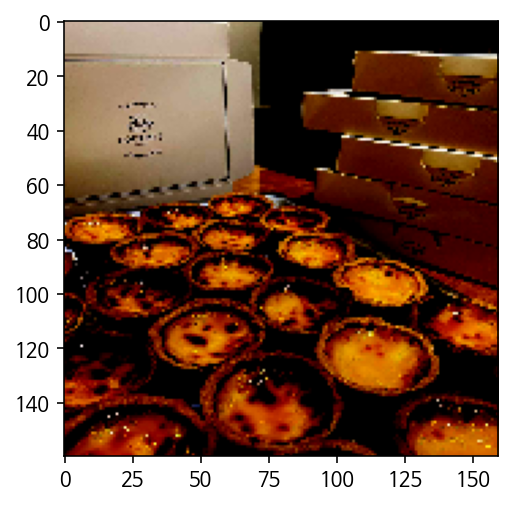

In [ ]:
plt.imshow(pic['pic']);

In [ ]:
pic['hashtag'], pic['deep_features'].shape, pic['pic'].shape

('맛집', (1280,), TensorShape([160, 160, 3]))

## ALS(Alternating Least Squares)

In [ ]:
# 기존 SparkSession을 가져 오거나 기존 SparkSession이없는 경우 local에 새 SparkSession을 작성
spark = SparkSession.builder.master('local').getOrCreate()

In [ ]:
als = ALS(userCol='image_id',
          itemCol='hashtag_id',
          implicitPrefs=True, # implicit dataset의 경우 True
          alpha=40)

als.setSeed(0)

hashtag_spark_df = spark.createDataFrame(hashtag_rec_data)

In [ ]:
als_model = als.fit(hashtag_spark_df)
als_model.write().overwrite().save('als')

In [ ]:
# 각 이미지마다 10개의 해시태그 생성(=추천)
recs = als_model.recommendForAllUsers(numItems=10).toPandas()
recs.head()

,image_id,recommendations
0,1580,"[(15420, 1.045361876487732), (15411, 1.0043426..."
1,4900,"[(19275, 0.07228410243988037), (4339, 0.072200..."
2,7340,"[(16160, 1.066439151763916), (7577, 1.03399765..."
3,7880,"[(8642, 1.0039523839950562), (4533, 0.99515420..."
4,471,"[(6229, 0.9771596193313599), (17361, 0.9740127..."


In [ ]:
hashtag_rec_data = []
for i in hashtag_metadata.index:
    hashtag_list = hashtag_metadata.loc[i, 'hashtags']
    for hashtag in hashtag_list:
        hashtag_rec_data.append(
            {'image_id': i, # hashtag_metadata의 해당 index 번호를 image_id로 부여
             'hashtag_id': hashtag_lookup[hashtag], # hashtag_lookup에 있는 해당 해시태그 번호를 hashtag_id로 부여
             'rating': 1}
        )
hashtag_rec_data = pd.DataFrame(hashtag_rec_data)
hashtag_rec_data

,image_id,hashtag_id,rating
0,0,13909,1
1,0,20783,1
2,0,16741,1
3,0,12463,1
4,0,9330,1
...,...,...,...
97464,7988,1938,1
97465,7988,18294,1
97466,7988,1937,1
97467,7988,8642,1


In [ ]:
hashtag_index = list(all_hashtags)

# hashtag_id로 hashtag 찾는 함수
def lookup_hashtag(hashtag_id):
    return hashtag_index[hashtag_id]

# hashtag_id_scores에서 (hashtag_id, score)마다 hashtag_id의 hashtag 찾는 함수
def lookup_hashtag_recs(hashtag_id_scores):
    return [lookup_hashtag(hashtag_id) for (hashtag_id, score) in hashtag_id_scores]

In [ ]:
# recommendations열에서 hashtag_id로 hashtag를 찾아 recommended_hashtags열에 저장
recs['recommended_hashtags'] = recs['recommendations'].apply(lookup_hashtag_recs)

recs.index = recs['image_id']

# recs 데이터프레임을 기준으로 hashtag_metadata 데이터프레임과 병합
recs = recs.join(hashtag_metadata, how='left')[['recommendations',
                                                 'recommended_hashtags',
                                                 'hashtags',
                                                 'image_local_name',
                                                 'main_hashtag']]

In [ ]:
# recommendations열 삭제
recs.drop('recommendations', axis=1, inplace=True)

# image_factors열 추가
image_factors = als_model.userFactors.toPandas()
image_factors.index = image_factors['id']
recs.join(image_factors);

In [ ]:
# recs 데이터프레임과 pics 데이터프레임을 image_local_name열 기준으로 병합
# 즉, deep_features열 추가
recs_deep = recs.join(pics, on='image_local_name', how='inner')
recs_deep.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6202 entries, 1580 to 6819
Data columns (total 8 columns):
recommended_hashtags    6202 non-null object
hashtags                6202 non-null object
image_local_name        6202 non-null object
main_hashtag            6202 non-null object
pic                     6202 non-null object
hashtag                 6202 non-null object
name                    6202 non-null object
deep_features           6202 non-null object
dtypes: object(8)
memory usage: 436.1+ KB


In [ ]:
recs.loc[0, 'image_local_name']

'21b92376-80f6-4c76-82ca-3f77020d14c5.jpg'

In [ ]:
len(hashtag_lookup), type(hashtag_lookup)

(22665, dict)

In [ ]:
# dict에서 dataframe으로 변환
hashtags_df = pd.DataFrame.from_dict(hashtag_lookup, orient='index')
hashtags_df.head()

,0
#ㄴㄴ,0
#ㅆㅅㄲ코로나,1
#ㅋㅋ,2
#ㅋㅋㅋ,3
#ㅋㅋㅋㅋㅋ,4


In [ ]:
hashtags_df = hashtags_df.reset_index()
hashtags_df.columns = ['hashtag', 'id']
hashtags_df.index = hashtags_df['id']
hashtags_df.drop('id', axis=1, inplace=True)
hashtags_df.head()

,hashtag
id,
0,#ㄴㄴ
1,#ㅆㅅㄲ코로나
2,#ㅋㅋ
3,#ㅋㅋㅋ
4,#ㅋㅋㅋㅋㅋ


In [ ]:
img_features = als_model.userFactors.toPandas()
img_features.head()

,id,features
0,0,"[-0.012714243493974209, 0.10341914743185043, 0..."
1,10,"[0.3526051640510559, 0.5091716647148132, 0.017..."
2,20,"[-0.10017742961645126, 0.8841888904571533, -0...."
3,30,"[-0.12377394735813141, 0.6306250691413879, -0...."
4,40,"[0.4564136564731598, 0.40965503454208374, 0.16..."


In [ ]:
hashtag_features = als_model.itemFactors.toPandas()
hashtag_features.head()

,id,features
0,0,"[0.01509659644216299, 0.0017607953632250428, 0..."
1,10,"[-0.00011559874837985262, 0.007936904206871986..."
2,20,"[0.025068409740924835, -0.041558656841516495, ..."
3,30,"[-0.0157428290694952, -0.018014883622527122, -..."
4,40,"[0.042852383106946945, -0.028385402634739876, ..."


In [ ]:
# recs_deep 데이터프레임에서 특정 열만 사용
recs_deep_clean = recs_deep[['image_local_name', 'hashtags', 'deep_features']]

img_features.index = img_features['id']
img_features.drop(['id'], axis=1, inplace=True)

# recs_deep_clean 데이터프레임에 img_features 추가
recommender_df = recs_deep_clean.join(img_features, how='inner')
recommender_df.head()

,image_local_name,hashtags,deep_features,features
1580,8da72903-89fa-4de5-bb3a-daacfd2298ed.jpg,"[#음식스타그램, #팔로우환영, #먹스타맞팔, #냠냠, #좋아요반사, #선팔하면맞팔...","[0.9471985, 0.06481725, 0.0, 0.066764064, 1.32...","[-0.038266606628894806, 0.8413495421409607, -0..."
4900,cc7cda6d-8216-4f92-ac51-00bb35477935.jpg,"[#안인정미소, #봉리단길맛집, #트렌치코트, #봉리단길]","[0.0, 0.0, 0.0, 0.23732445, 0.29860467, 1.7929...","[0.019381925463676453, -0.039352789521217346, ..."
7340,e7fa9944-9c6f-42f7-bbaf-5cd0d0e9921d.jpg,"[#일상, #반려견, #광교, #멍멍이, #좋아요, #펫스타그램, #강아지, #와라...","[0.0, 0.2017374, 0.0, 0.00091238966, 0.0251439...","[0.45813071727752686, -0.24976076185703278, 0...."
7880,a254b88a-dd96-4a42-8429-eacb35efbfee.jpg,"[#최승자, #빈배처럼텅비어, #소통, #좋은시, #아침독서, #일상, #좋은글, ...","[0.0, 0.0, 0.06315428, 0.20160753, 0.018703956...","[0.6349372267723083, -0.2291695773601532, 0.25..."
471,2d107176-be17-4e54-baa2-a170a9c47470.jpg,"[#일상, #선팔하면맞팔, #망리단길, #소통해요, #맛스타그램, #망원동맛집, #...","[2.7989383, 0.0, 0.0, 0.0, 2.9143822, 0.0, 0.0...","[0.03780640289187431, 0.7162878513336182, -0.5..."


# Test 데이터로 성능 체크

#### 모든 해시태그 목록 가져오기

In [ ]:
json_file_names_test = os.listdir('/content/drive/My Drive/비타민 팀프로젝트 1조/데이터셋/test/metadata')

# '.json'이라는 5글자 삭제하고 해시태그 이름만 가져오기
hashtags_test = [hashtag_test[:-5] for hashtag_test in json_file_names_test]
print("search_hashtag:",', '.join(hashtags_test))
print("search_hashtag 갯수:", len(hashtags_test))

search_hashtag: 카페탐방, 카페투어, 펫스타그램, 반려동물, 아기스타그램, 음식스타그램, 육아, 맛스타그램, 여행일기, 운스타그램, 여행추억, 벌크업, 북스타그램, 독서스타그램, 전신스타그램, 얼스타그램
search_hashtag 갯수: 16


In [ ]:
# 해시태그 metadata를 모두 합친 전체 데이터프레임 생성
hashtag_metadata_test = []
for hashtag_test in hashtags_test: 
    hashtag_metadata_test.append(pd.read_json(f'/content/drive/My Drive/비타민 팀프로젝트 1조/데이터셋/test/metadata/{hashtag_test}.json'))
hashtag_metadata_test = reduce(lambda x, y: pd.concat([x, y]), hashtag_metadata_test)
pd.DataFrame.reset_index(hashtag_metadata_test, drop=True, inplace=True)
hashtag_metadata_test

,likes,hashtags,image_local_name,search_hashtag
0,319,[#크래프터],4171f3bb-48cd-4084-9474-3fd6060d05c3.jpg,카페탐방
1,407,[],06f38194-8c48-490c-a2f2-a4a2dea3a749.jpg,카페탐방
2,276,"[#팔로우, #충장로, #광주, #휴일, #휴무스타그램, #좋반튀, #셀스타그램, ...",c11b86d2-6a83-41d8-b7c4-c146cd6b572f.jpg,카페탐방
3,294,[],c7330923-9884-49ee-a427-69114949da32.jpg,카페탐방
4,454,[],64e419fa-1f88-4a8b-9989-ebee560fd93f.jpg,카페탐방
...,...,...,...,...
1745,38,[],3adf7c10-889e-472c-b321-43e9f2d7f83b.jpg,얼스타그램
1746,67,[],e5619c02-fba3-44cd-a3d3-9d1b1ed3058a.jpg,얼스타그램
1747,335,[],7fad4f63-ab64-44ce-b3e2-0af1d35b50bc.jpg,얼스타그램
1748,53,"[#직장인, #맛집, #신사동, #이태원, #강남, #셀스타그램, #아이폰, #서면...",3677201d-e8e5-4075-bfd5-5610cba17acb.jpg,얼스타그램


In [ ]:
# 카테고리에 해당하는 main_hashtag 열 생성
hashtag_metadata_test['main_hashtag'] = hashtag_metadata_test['search_hashtag'].apply(lambda x: "맛집" if (x == "맛스타그램" or x == "음식스타그램") 
                                                                            else "육아" if (x == "육아" or x == "아기스타그램") 
                                                                            else "펫스타그램" if (x == "펫스타그램" or x == "반려동물")
                                                                            else "카페" if (x == "카페투어" or x == "카페탐방")
                                                                            else "셀카" if (x == "얼스타그램" or x == "전신스타그램")
                                                                            else "책" if (x == "북스타그램" or x == "독서스타그램")
                                                                            else "여행" if (x == "여행일기" or x == "여행추억")
                                                                            else "운동" if (x == "벌크업" or x == "운스타그램") else x)

In [ ]:
# NaN이 있는 행 확인
sum(hashtag_metadata_test["image_local_name"]=="NaN")

92

In [ ]:
# NaN이 있는 행 제거
index_NaN_test = hashtag_metadata_test[hashtag_metadata_test["image_local_name"]=="NaN"].index
hashtag_metadata_test.drop(index_NaN_test, inplace=True)
sum(hashtag_metadata_test["image_local_name"]=="NaN")

0

In [ ]:
# index 재정렬
pd.DataFrame.reset_index(hashtag_metadata_test, drop=True, inplace=True)
hashtag_metadata_test.head()

,likes,hashtags,image_local_name,search_hashtag,main_hashtag
0,319,[#크래프터],4171f3bb-48cd-4084-9474-3fd6060d05c3.jpg,카페탐방,카페
1,407,[],06f38194-8c48-490c-a2f2-a4a2dea3a749.jpg,카페탐방,카페
2,276,"[#팔로우, #충장로, #광주, #휴일, #휴무스타그램, #좋반튀, #셀스타그램, ...",c11b86d2-6a83-41d8-b7c4-c146cd6b572f.jpg,카페탐방,카페
3,294,[],c7330923-9884-49ee-a427-69114949da32.jpg,카페탐방,카페
4,454,[],64e419fa-1f88-4a8b-9989-ebee560fd93f.jpg,카페탐방,카페


In [ ]:
# 해시태그가 아예 없는 행 확인
index_no_hashtag_test = []
for i in range(len(hashtag_metadata_test)):
  if len(hashtag_metadata_test.iloc[i, 1])==0:
    index_no_hashtag_test.append(i)
print(len(index_no_hashtag_test))

467


In [ ]:
# 해시태그가 아예 없는 행 제거
hashtag_metadata_test.drop(index_no_hashtag_test, inplace=True)

index_no_hashtag_test = []
for i in range(len(hashtag_metadata_test)):
  if len(hashtag_metadata_test.iloc[i, 1])==0:
    index_no_hashtag_test.append(i)
print(len(index_no_hashtag_test))

0


In [ ]:
# index 재정렬
pd.DataFrame.reset_index(hashtag_metadata_test, drop=True, inplace=True)
hashtag_metadata_test.head()

,likes,hashtags,image_local_name,search_hashtag,main_hashtag
0,319,[#크래프터],4171f3bb-48cd-4084-9474-3fd6060d05c3.jpg,카페탐방,카페
1,276,"[#팔로우, #충장로, #광주, #휴일, #휴무스타그램, #좋반튀, #셀스타그램, ...",c11b86d2-6a83-41d8-b7c4-c146cd6b572f.jpg,카페탐방,카페
2,58,[#허피],a028a0e7-04ee-4a59-a31c-1bba761c3fd2.jpg,카페탐방,카페
3,121,"[#예쁘다그램, #드라이브, #예쁘다, #구례, #카페투어, #카페, #하동, #카...",109c397b-d6d0-4de4-8e5a-95499c4c77ac.jpg,카페탐방,카페
4,35,"[#셀카, #감사합니당, #사진결정, #접선완료, #셀스타그램, #선팔, #태평카페...",a0cd5c41-f629-46a5-a830-ead19a8adeea.jpg,카페탐방,카페


#### 결과 확인 및 성능 체크

In [ ]:
# 그래프에서 한글표현을 위해 폰트 설치
%config InlineBackend.figure_format = 'retina'
!apt -qq -y install fonts-nanum > /dev/null

import matplotlib.font_manager as fm
fontpath = '/usr/share/fonts/truetype/nanum/NanumBarunGothic.ttf'
font = fm.FontProperties(fname=fontpath, size=9)

# 기본 글꼴 변경
import matplotlib as mpl
mpl.font_manager._rebuild()
mpl.pyplot.rc('font', family='NanumBarunGothic')

In [ ]:
import warnings
warnings.filterwarnings(action='ignore')
# warnings.filterwarnings(action='default')

In [ ]:
# main_hashtag의 index번째 사진의 성능 체크
def show_accuracy(main_hashtag, index):
    test_image_name = hashtag_metadata_test[hashtag_metadata_test['main_hashtag']==main_hashtag].iloc[index,2]
    img = mpimg.imread(f'/content/drive/My Drive/비타민 팀프로젝트 1조/데이터셋/test/data/{main_hashtag}/{test_image_name}')
    plt.figure(figsize=(9, 9))
    plt.title(f'Main Hashtag: {main_hashtag}', fontsize=30)        
    plt.imshow(img)
    
    recommended_hashtags = generate_hashtags(f'/content/drive/My Drive/비타민 팀프로젝트 1조/데이터셋/test/data/{main_hashtag}/{test_image_name}')
    original_hashtags = hashtag_metadata_test[hashtag_metadata_test['main_hashtag']==main_hashtag].iloc[index,1]
    print("추천 해시태그:",', '.join(recommended_hashtags))
    print("기존 해시태그:",', '.join(original_hashtags))
    
    score = 0
    for recommended_hashtag in recommended_hashtags:
      if recommended_hashtag in original_hashtags:
        score += 1
    accuracy = round(score/len(original_hashtags)*100,2)
    print("정확도: "+str(accuracy)+"%")

In [ ]:
show_accuracy('여행', 0) # 저작권 문제가 있어 결과 출력을 삭제했습니다.

In [ ]:
show_accuracy('셀카', 0) # 저작권 문제가 있어 결과 출력을 삭제했습니다.

In [ ]:
show_accuracy('육아', 0) # 저작권 문제가 있어 결과 출력을 삭제했습니다.

In [ ]:
show_accuracy('카페', 0) # 저작권 문제가 있어 결과 출력을 삭제했습니다.

In [ ]:
show_accuracy('운동', 0) # 저작권 문제가 있어 결과 출력을 삭제했습니다.

In [ ]:
show_accuracy('펫스타그램', 0) # 저작권 문제가 있어 결과 출력을 삭제했습니다.

In [ ]:
show_accuracy('맛집', 0) # 저작권 문제가 있어 결과 출력을 삭제했습니다.

In [ ]:
show_accuracy('책', 0) # 저작권 문제가 있어 결과 출력을 삭제했습니다.

In [ ]:
# main_hashtag 전체 성능 체크
def show_main_hashtag_accuracy(main_hashtag):
  main_hashtag_len = len(hashtag_metadata_test[hashtag_metadata_test['main_hashtag']==main_hashtag])
  accuracy = 0
  for index in range(len(hashtag_metadata_test[hashtag_metadata_test['main_hashtag']==main_hashtag])):
    test_image_name = hashtag_metadata_test[hashtag_metadata_test['main_hashtag']==main_hashtag].iloc[index,2]
    try:
      recommended_hashtags = generate_hashtags(f'/content/drive/My Drive/비타민 팀프로젝트 1조/데이터셋/test/data/{main_hashtag}/{test_image_name}')
      original_hashtags = hashtag_metadata_test[hashtag_metadata_test['main_hashtag']==main_hashtag].iloc[index,1]
      
      score = 0
      for recommended_hashtag in recommended_hashtags:
        if recommended_hashtag in original_hashtags:
          score += 1
      accuracy += (score/len(original_hashtags))*100
    except Exception as e:
      error_type = type(e).__name__
      if error_type == "NotFoundError":
        main_hashtag_len -= 1
        pass
      else:
        print(e)

  main_hashtag_accuracy = round(accuracy/main_hashtag_len,2)
  return main_hashtag_accuracy

In [ ]:
food_accuracy = show_main_hashtag_accuracy('맛집')
print("맛집 정확도: "+str(food_accuracy)+"%")

맛집 정확도: 16.77%


In [ ]:
book_accuracy = show_main_hashtag_accuracy('책')
print("책 정확도: "+str(book_accuracy)+"%")

책 정확도: 21.92%


In [ ]:
health_accuracy = show_main_hashtag_accuracy('운동')
print("운동 정확도: "+str(health_accuracy)+"%")

운동 정확도: 10.52%


In [ ]:
selfie_accuracy = show_main_hashtag_accuracy('셀카')
print("셀카 정확도: "+str(selfie_accuracy)+"%")

셀카 정확도: 20.43%


In [ ]:
babies_accuracy = show_main_hashtag_accuracy('육아')
print("육아 정확도: "+str(babies_accuracy)+"%")

육아 정확도: 8.3%


In [ ]:
travel_accuracy = show_main_hashtag_accuracy('여행')
print("여행 정확도: "+str(travel_accuracy)+"%")

여행 정확도: 15.53%


In [ ]:
cafe_accuracy = show_main_hashtag_accuracy('카페')
print("카페 정확도: "+str(cafe_accuracy)+"%")

카페 정확도: 10.03%


In [ ]:
pet_accuracy = show_main_hashtag_accuracy('펫스타그램')
print("펫스타그램 정확도: "+str(pet_accuracy)+"%")

펫스타그램 정확도: 18.42%


In [ ]:
# 모든 main_hashtag의 성능을 합친 총 성능 체크
def show_all_accuracy(main_hashtag_list):
  main_hashtag_len = len(main_hashtag_list)
  accuracy = 0
  for main_hashtag in main_hashtag_list:
    accuracy += show_main_hashtag_accuracy(main_hashtag)
  all_accuracy = round(accuracy/main_hashtag_len,2)
  return all_accuracy

In [ ]:
main_hashtag_list = ['카페', '맛집', '펫스타그램', '책', '운동', '셀카', '육아', '여행']
all_accuracy = show_all_accuracy(main_hashtag_list)
print("총 정확도: "+str(all_accuracy)+"%")

총 정확도: 15.24%


# 새 이미지에 대한 해시태그 생성

In [ ]:
# 코사인 유사성에 기반한 K개의 최근접이웃을 찾는 함수
def find_neighbor_vectors(image_path, k=5, recommender_df=recommender_df):
    # 비슷한 이미지에 대한 img_features(이미지 피쳐, 즉 사용자 벡터)를 찾는다.
    prep_image = prepare_image(image_path)
    pics = extract_features(prep_image, neural_network)
    rdf = recommender_df.copy()
    rdf['dist'] = rdf['deep_features'].apply(lambda x: cosine(x, pics))
    rdf = rdf.sort_values(by='dist')
    return rdf.head(k)

In [ ]:
def generate_hashtags(image_path):
    fnv = find_neighbor_vectors(image_path, k=5, recommender_df=recommender_df)
    # 코사인 유사성에 기반하여 5개의 사용자 벡터의 평균을 구한다.
    features = []
    for item in fnv.features.values:
        features.append(item)

    avg_features = np.mean(np.asarray(features), axis=0)
    
    # 앞서 구한 이미지(사용자) 피쳐의 평균, 즉 avg_features을 hashtag_features와 dot product하여 새로운 dot_product열 생성
    hashtag_features['dot_product'] = hashtag_features['features'].apply(lambda x: np.asarray(x).dot(avg_features))
    
    # 가장 높은 dot product를 가진 해시태그 상위 10개 추출
    final_recs = hashtag_features.sort_values(by='dot_product', ascending=False).head(10)

    # hastag_id로 hashtag 찾아서 output에 저장
    output = []
    for hashtag_id in final_recs.id.values:
        output.append(hashtags_df.iloc[hashtag_id]['hashtag'])
    return output

In [ ]:
def show_results(test_image):
    img = mpimg.imread(f'/content/drive/My Drive/비타민 팀프로젝트 1조/데이터셋/show_results/{test_image}.jpg')
    plt.figure(figsize=(9, 9)) 
    plt.imshow(img)
    
    recommended_hashtags = generate_hashtags(f'/content/drive/My Drive/비타민 팀프로젝트 1조/데이터셋/show_results/{test_image}.jpg')
    print(', '.join(recommended_hashtags))

In [ ]:
import warnings
warnings.filterwarnings(action='ignore')
# warnings.filterwarnings(action='default')

#육아, #아기스타그램, #육아스타그램, #육아소통, #생후, #맘스타그램, #육아맘, #딸스타그램, #육아일상, #도치맘


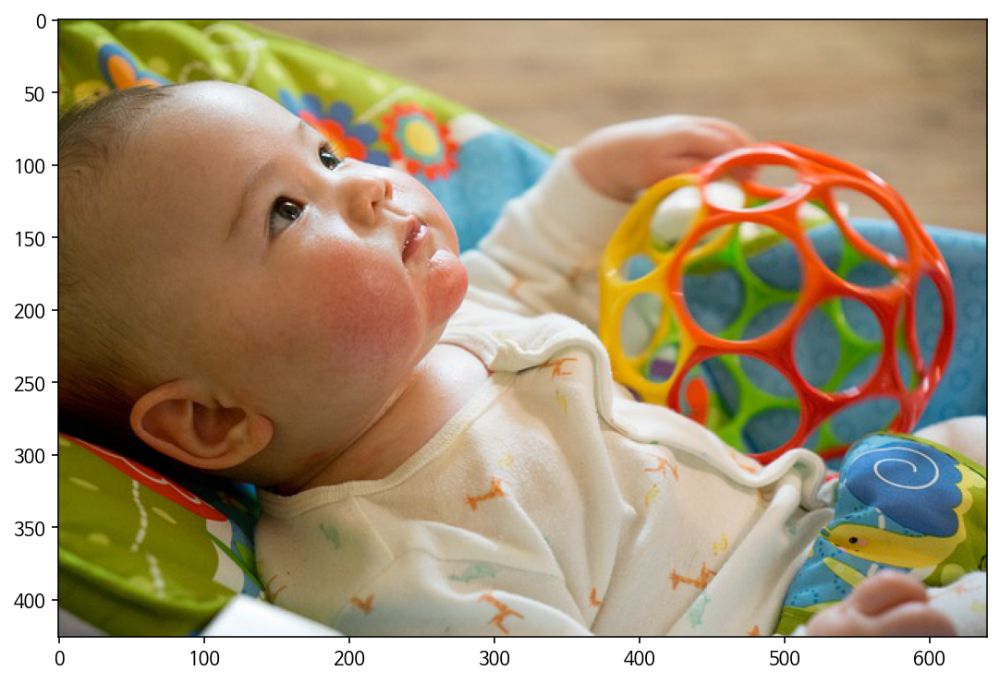

In [ ]:
show_results('육아1')

#육아, #육아스타그램, #육아소통, #아기스타그램, #육아맘, #아들맘, #딸스타그램, #생후, #맘스타그램, #도치맘


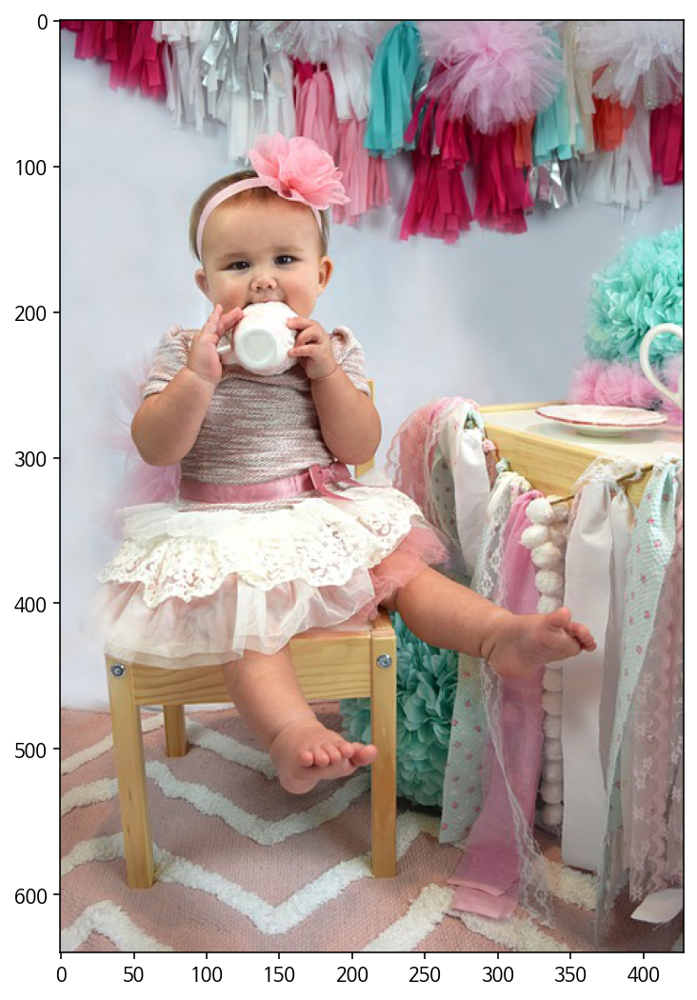

In [ ]:
show_results('육아2')

#맛스타그램, #먹스타그램, #맛집, #먹방, #음식스타그램, #일상, #소통, #집밥, #데일리, #맞팔


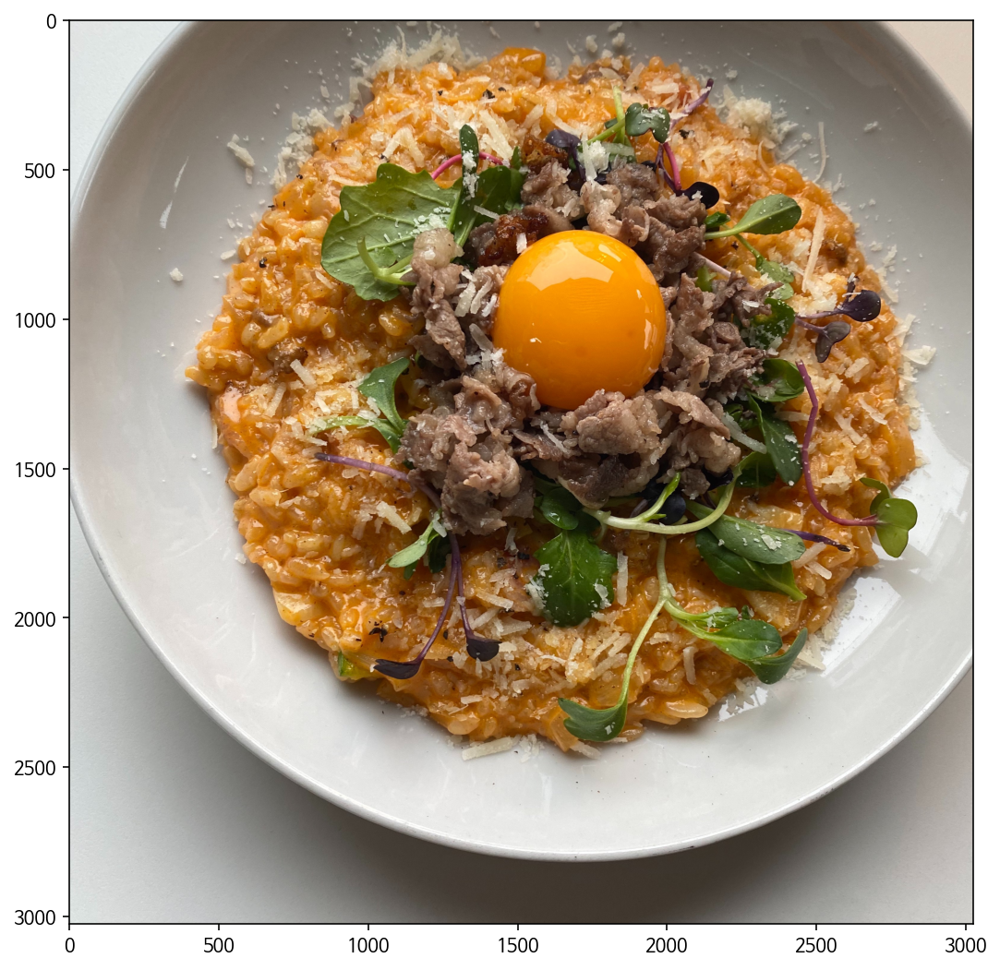

In [ ]:
show_results('맛집1')

#일상, #먹스타그램, #데일리, #소통, #맛스타그램, #좋아요, #맞팔, #육아, #일상스타그램, #맛집


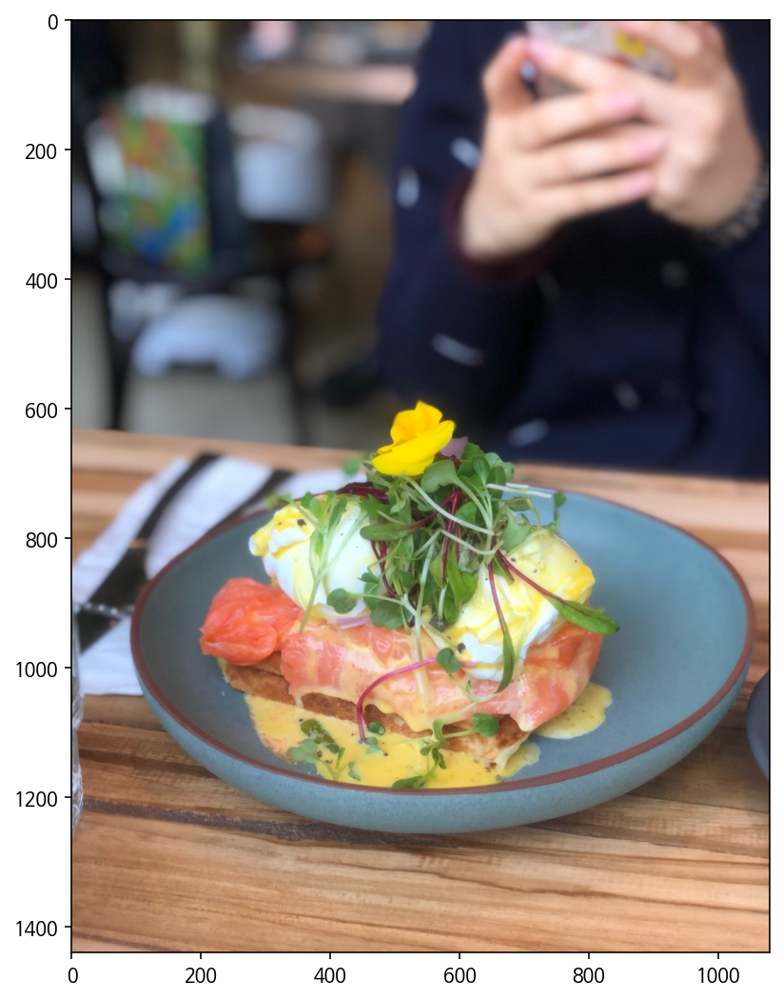

In [ ]:
show_results('맛집2')

#멍스타그램, #펫스타그램, #반려견, #강아지, #개스타그램, #댕댕이, #반려동물, #독스타그램, #견스타그램, #멍멍이


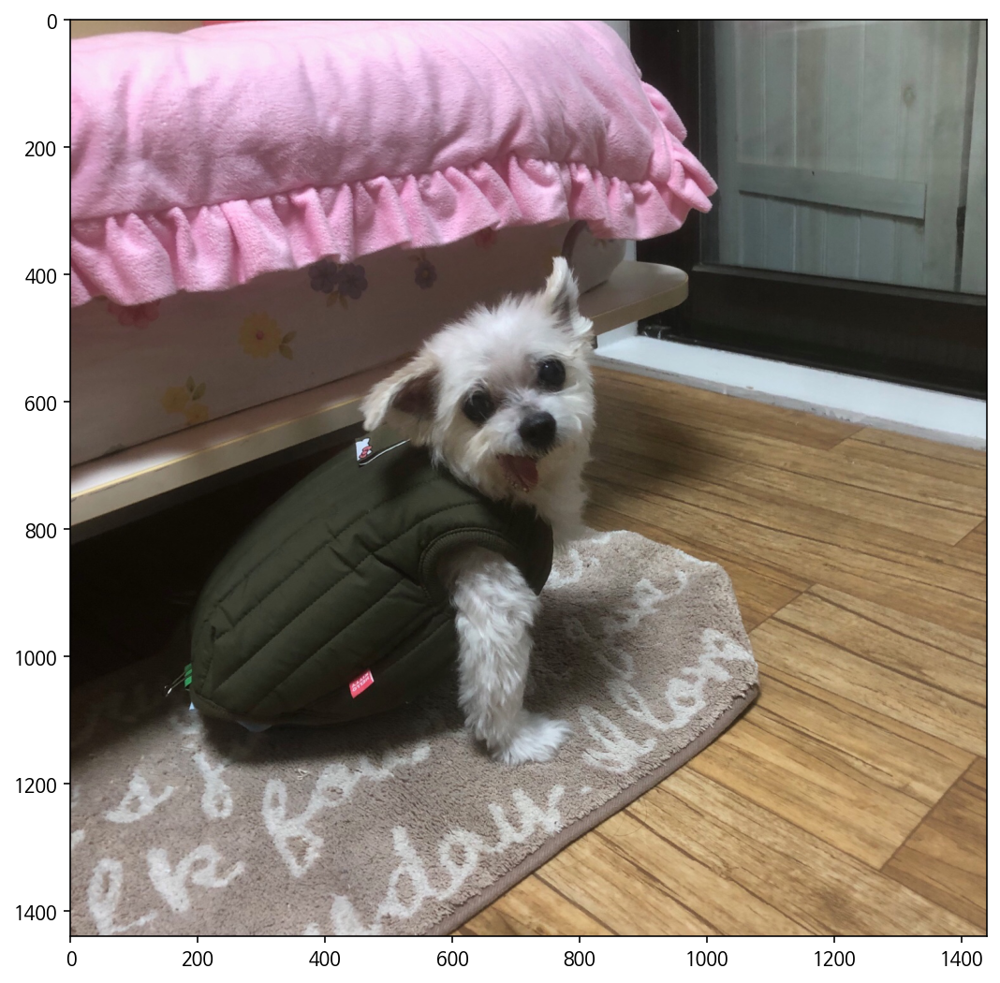

In [ ]:
show_results('펫스타그램1')

#고양이, #반려동물, #냥스타그램, #펫스타그램, #반려묘, #캣스타그램, #집사, #미묘, #코숏, #고양이그램


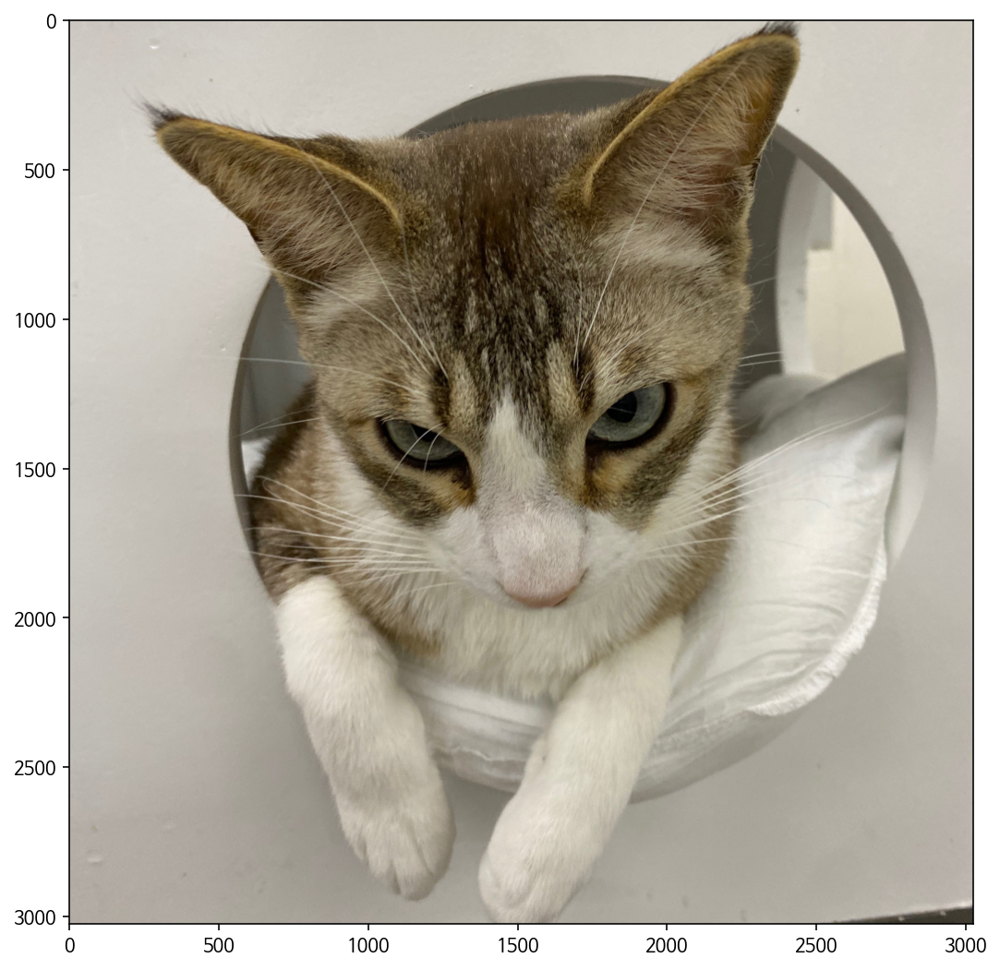

In [ ]:
show_results('펫스타그램2')

#럽스타그램, #제주도, #여행중, #여행, #떠나요, #여행병, #또가고싶다, #추억팔이, #여행추억, #제주


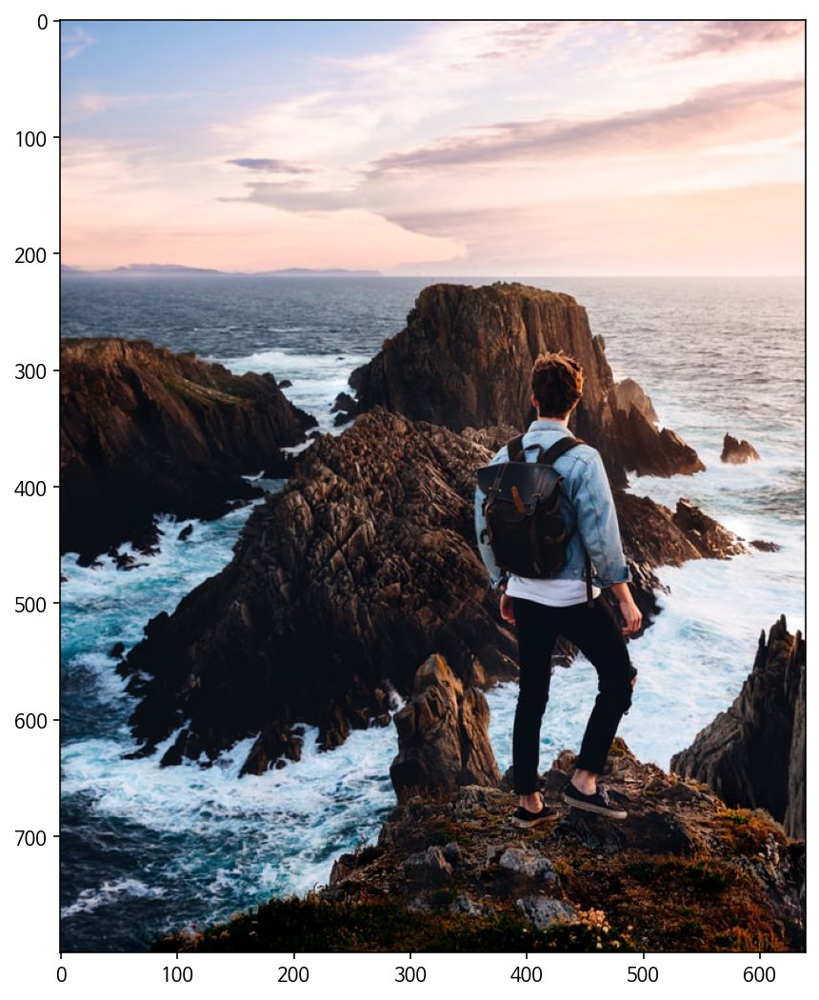

In [ ]:
show_results('여행1')

#여행스타그램, #여행추억, #여행일기, #여행, #여행사진, #여행기록, #여행에미치다, #여행그램, #추억팔이, #세계여행


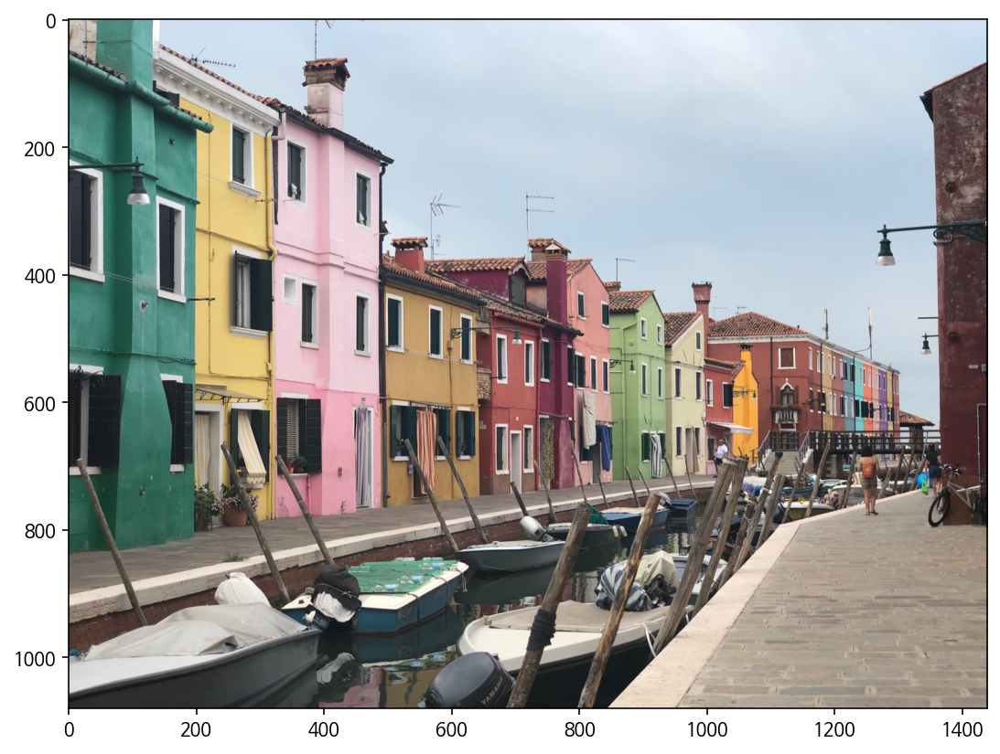

In [ ]:
show_results('여행2')

#운동하는여자, #헬스타그램, #운스타그램, #운동하는남자, #다이어트, #운동, #벌크업, #헬스, #운동스타그램, #셀스타그램


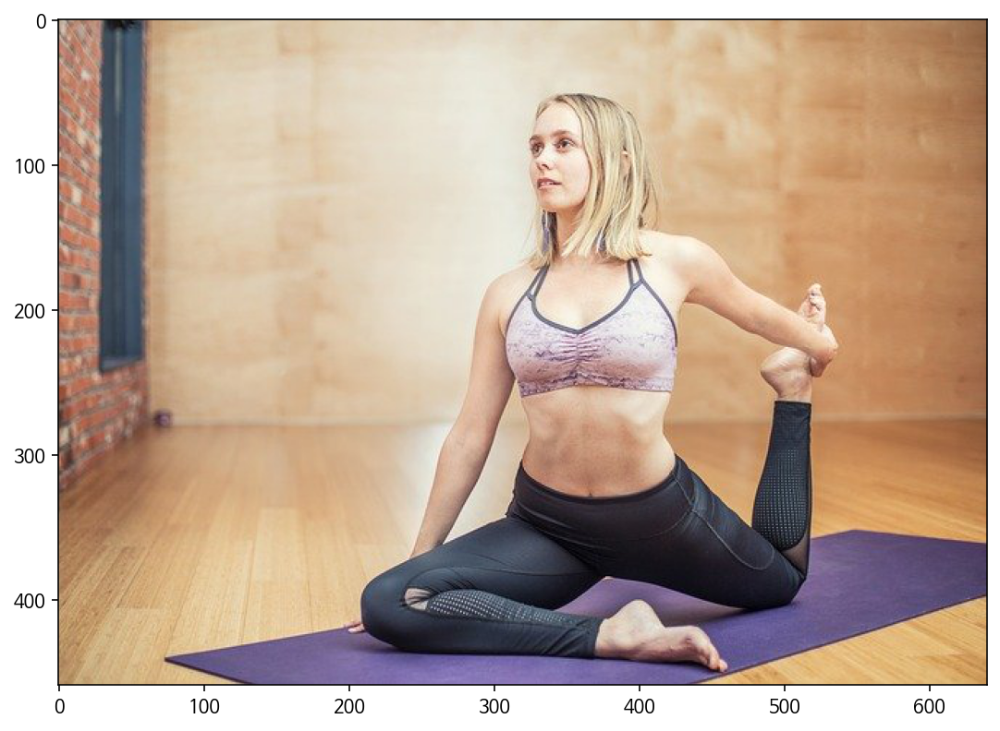

In [ ]:
show_results('운동1')

#벌크업, #운동하는남자, #헬스타그램, #헬스, #다이어트, #운스타그램, #운동하는여자, #헬린이, #웨이트, #운동


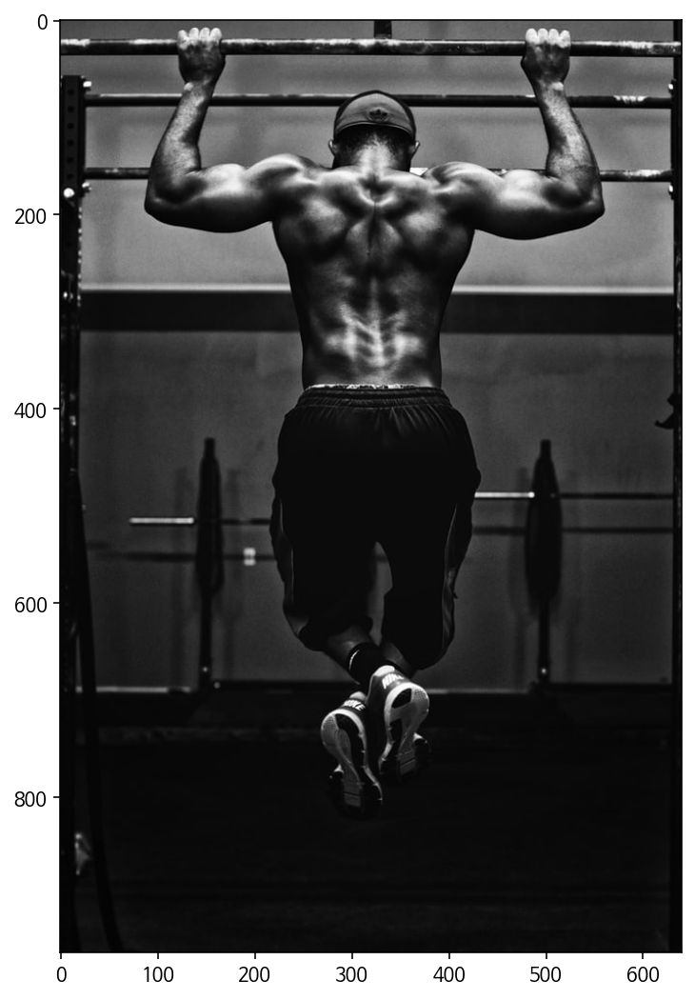

In [ ]:
show_results('운동2')

#카페, #카페스타그램, #카페투어, #카페탐방, #커피, #카페그램, #카페추천, #봄, #데이트, #커피스타그램


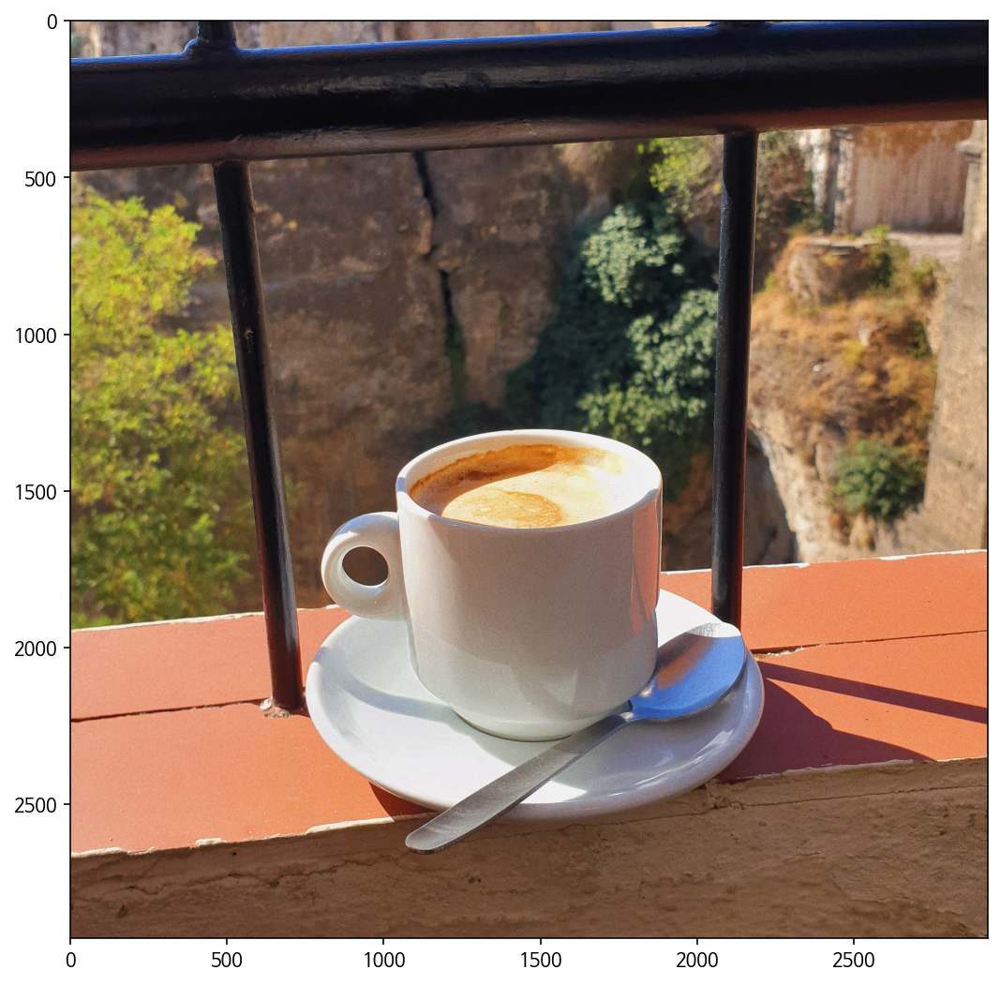

In [ ]:
show_results('카페1')

#카페투어, #카페탐방, #카페스타그램, #카페, #카페추천, #카페그램, #커피, #커피스타그램, #카페인테리어, #디저트카페


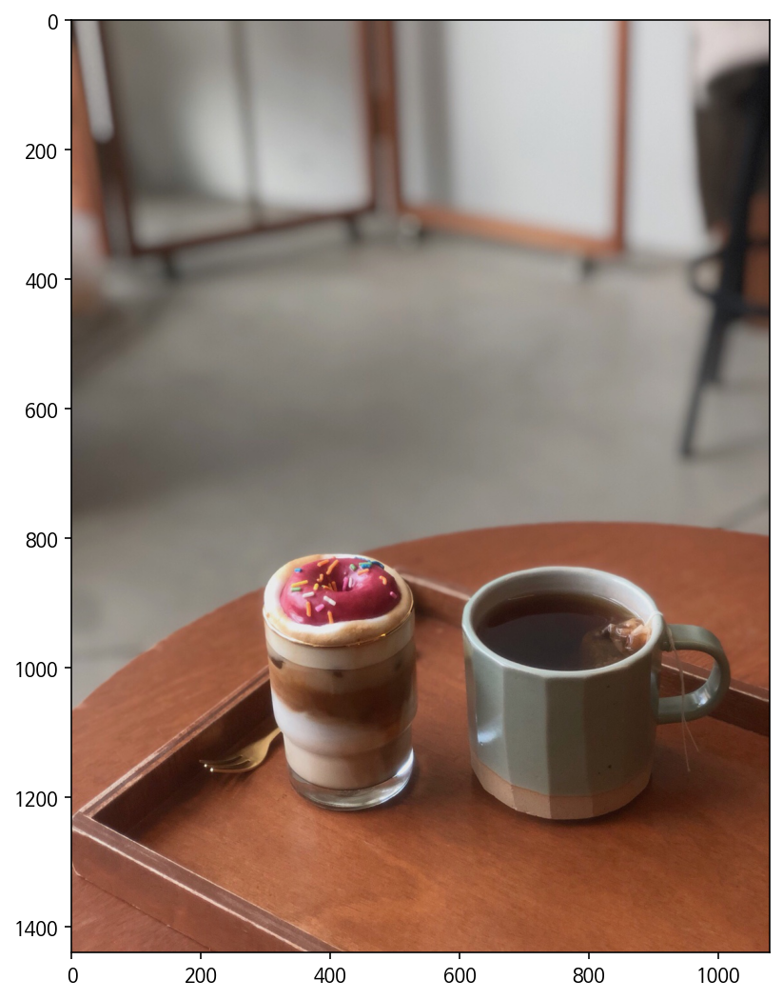

In [ ]:
show_results('카페2')

#독서스타그램, #북스타그램, #책스타그램, #독서, #책, #일상, #책추천, #책리뷰, #책읽기, #데일리


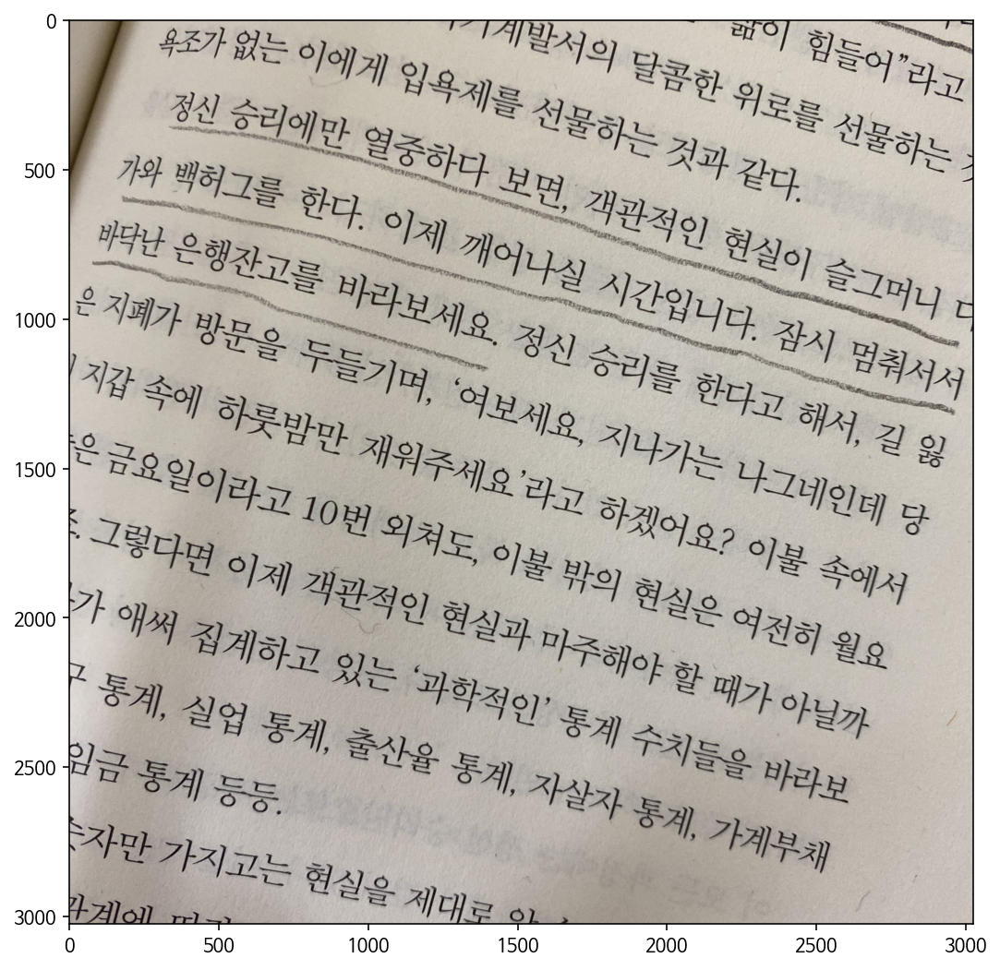

In [ ]:
show_results('책1')

#북스타그램, #책스타그램, #독서스타그램, #독서, #책, #책추천, #코로나, #책리뷰, #일상, #책읽기


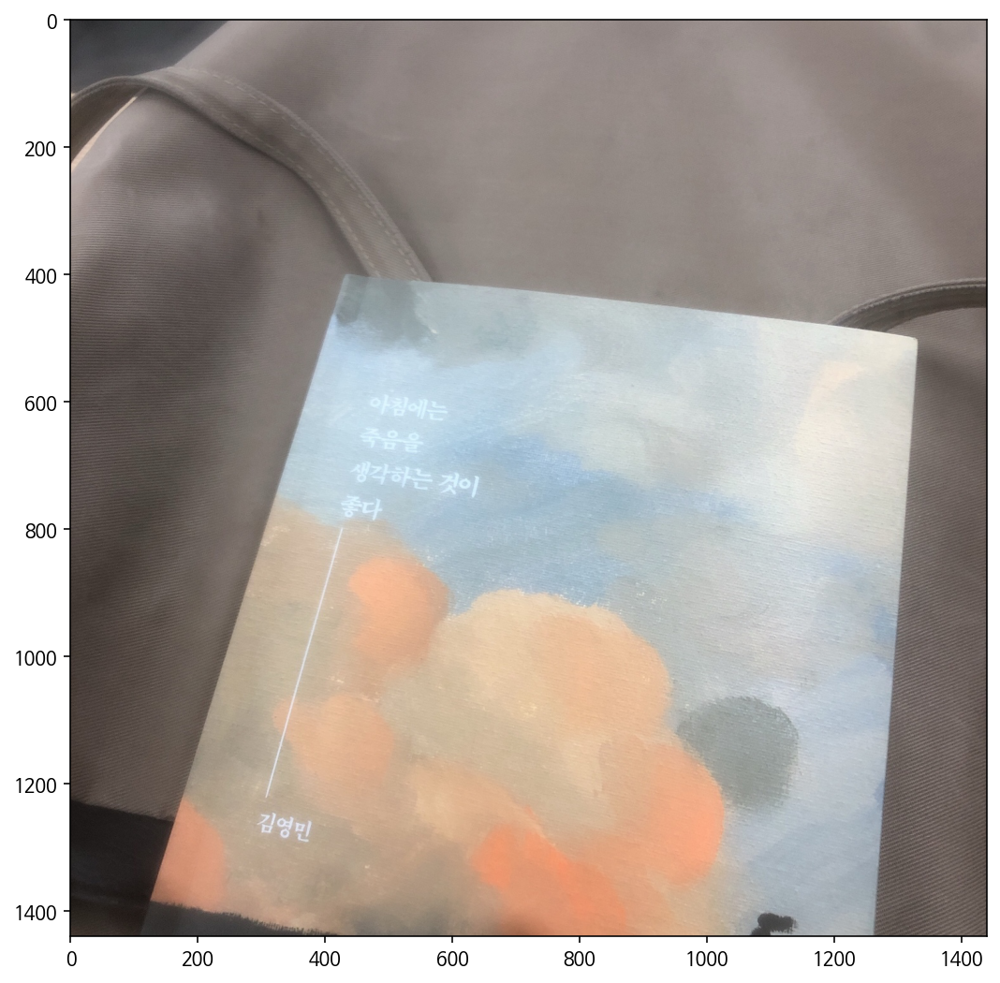

In [ ]:
show_results('책2')

#데일리, #일상, #맞팔, #소통, #좋아요, #팔로우, #선팔, #셀카, #셀스타그램, #셀피


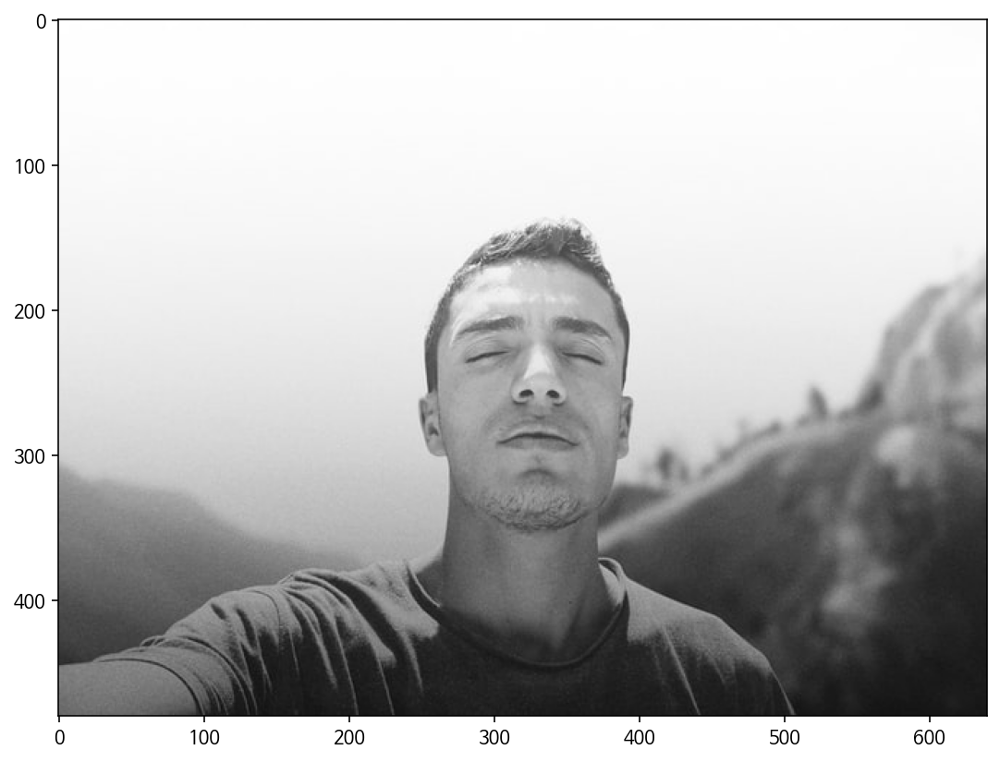

In [ ]:
show_results('셀카1')

#셀카, #셀피, #셀스타그램, #얼스타그램, #일상, #데일리, #오오티디, #소통, #전신스타그램, #맞팔


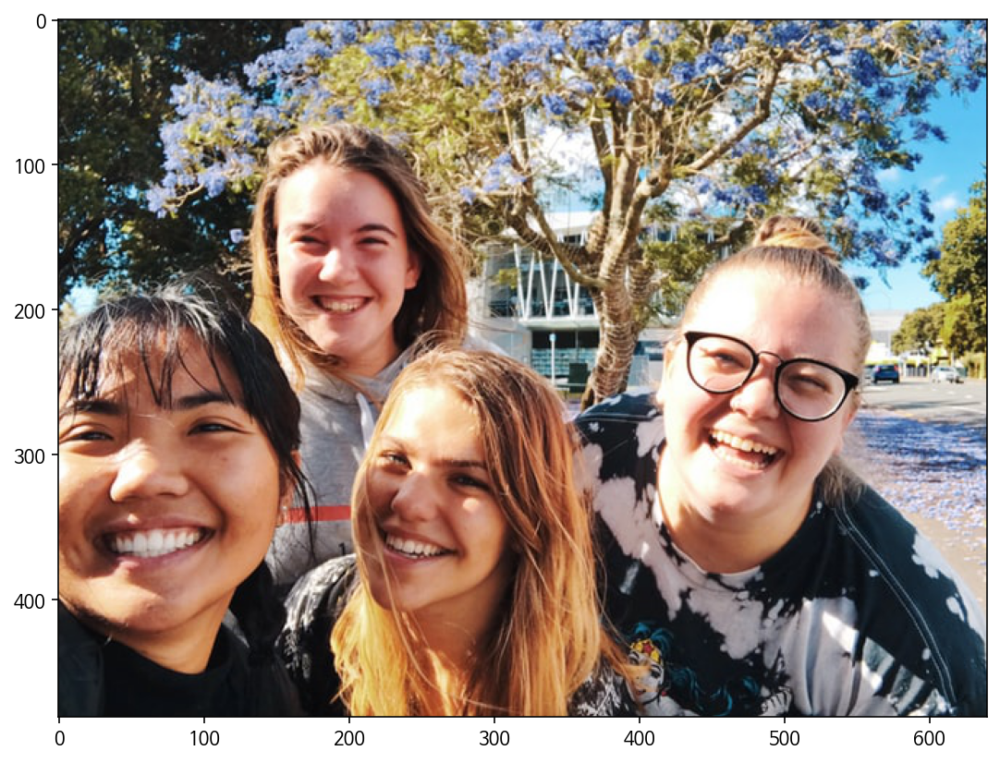

In [ ]:
show_results('셀카2')